In [1]:
import numpy as np

import matplotlib as mpl
mpl.rc('image', cmap='gray')
from matplotlib import pyplot as plt

from pyramids import Pyramid as pyr
from pyrwidget import LayerTab as lt
from pyrwidget import MultiLayer as ml

from skimage.draw import circle, line_nd, line

from ipywidgets import interact

# Rendre visible l'invisible : la radiographie numérique

### Mots clés

Contraste, intégrale, Beer-Lambert, loi de Poisson, radiographie, rehaussement

## Loi de Beer-Lambert

Tout matériau est caractérisé par un *coefficient linéaire d'atténuation* $\mu$ qui a comme dimension l'inverse d'une longueur. A la traversée d'un milieu, l'intensité initiale d'un faisceau de rayons X ($I_0$) est atténuée selon la loi de Beer-Lambert suivante :
$$
I = I_0 \exp(-p),
$$
où :
$$
p = \left(-\int_L \mu(l)dl\right),
$$
et $L$ est la ligne suivie par les photons X. Nous raffinerons cette formule au fur et à mesure du cours, car cette modélisation est incomplète. A commencer par l'absence de bruit statistique ! En réalité, l'observation $I$ fluctue autour de la valeur donnée par la loi de Beer-Lambert selon une loi de Poisson :
$$
I \sim \mathcal{P}\left(I_0 \exp\left(-\int_L \mu(l)dl\right)\right).
$$

En pratique, si on mesure $I$, on s'intéresse plutôt à l'intégrale $p$, obtenue par passage au logarithme:
$$
p=\log(I_0)-\log(I).
$$

### Questions

1. Ecrire une fonction `sumCols(img)` qui prend une image 2D en entrée et retourne le profil somme le long de l'axe vertical (l'axe des $x$ de l'image). A quoi correspond cette fonction dans la loi de Beer-Lambert ?
2. Ecrire une fonction `noisy(img,I0)` qui calcule la projection selon la loi de Beer-Lambert (avec sa statistique de Poisson), et renvoie la partie linéaire $p$.
3. Une loi de Poisson a pour densité de probabilité $P(X=k)=\frac{\lambda^k}{k!}e^{-\lambda}$. Calculer l'espérance et la variance d'une variable aléatoire suivant une loi de Poisson. Qu'en déduisez-vous ? (Faites le calcul !)
4. Jouer avec le widget en variant le rayon de l'insert de contraste, la valeur de ce contraste, ainsi que `I0`. Qu'observez-vous ? Est-il facile d'identifier cet insert dans l'image ? et sur le profil ? Pourquoi ?

#### Encore un peu de maths !...
5. Cet exemple simple utilise une projection (dite "parallèle") de disques centrés, uniformes ; si $\mu$ est le coefficient linéaire d'atténuation d'un disque centré de rayon $R$, pouvez-vous calculer sa projection analytiquement ?
6. En déduire la projection analytique de l'objet du widget : un disque uniforme de rayon $R_0$ et de coefficient d'atténuation $\mu$, dans lequel on a un disque uniforme de rayon $R_1$ et de coefficient d'atténuation $\mu+\Delta\mu$. Quelle est la valeur maximale de cette projection ? On la notera $C$.
7. On dira que le "fond" est donné par la valeur de la projection aux bords du disque de contraste ; autrement dit, le fond est la valeur de la projection que vous avez calculée, prise en $R_1$ ; quelle est cette valeur ? On la notera $B$.
8. Calculer le contraste relatif $(C-B)/B$ ; pouvez-vous le simplifier si $R_1$ est "petit" devant $R_0$ ? Comparez alors ce ratio au contraste relatif des coefficients linéaires d'atténuation des deux disques.

In [2]:
def sumCols(img):
    #### Votre code ici
    return img.sum(axis=1)

def noisy(profil,I0):
    #### Votre code ici
    #### Vous pouvez appeler une réalisation d'une loi de Poisson
    #### de paramètre lambda avec la fonction:
    #### np.random.poisson(lambda)
    np.random.seed(26)
    I = np.clip(np.random.poisson(I0*np.exp(-profil)), a_min=0.001, a_max=None)
    return np.log(I0) - np.log(I)

In [3]:
# Création d'une image de test
img0 = np.zeros((256,256))
rr, cc = circle(127.5,127.5,100,img0.shape)
mu_bkg = 0.03
img0[rr,cc] = mu_bkg


def visuProfil(rayon,contraste,I0):
    img = img0.copy()
    rr, cc = circle(127.5,127.5,rayon,img.shape)
    img[rr,cc] += contraste
    profil = sumCols(img)

    f,ax = plt.subplots(1,2,figsize=(15,5))
    ax[0].imshow(img)
    ax[1].plot(profil,lw=4,alpha=0.4)
    ax[1].plot(noisy(profil,I0),c='r',alpha=0.4)
    ax[1].grid()
    ax[1].legend(['Signal parfait', 'Signal bruité'])
    
interact(lambda rayon,contrasteX10,k: visuProfil(rayon,contrasteX10*0.1,10**k),rayon=(0,90,10),contrasteX10=(0.01,0.4,0.01),k=(2,6,1))

interactive(children=(IntSlider(value=40, description='rayon', max=90, step=10), FloatSlider(value=0.2, descri…

<function __main__.<lambda>(rayon, contrasteX10, k)>

## Radiographie planaire

### Questions

1. Visualisez une radiographie planaire "brute" ci-dessous (placer le curseur `vmin` tout à gauche et le curseur `vmax` tout à droite ; soyez patients : le chargement peut prendre un peu de temps) ; que représente la courbe rouge ? Que pouvez-vous dire de l'image chargée ?
2. Quelles observations faites-vous sur les zones de feu nu ? Avez-vous un moyen simple d'estimer l'intensité $I_0$ nécessaire à la normalisation (on supposera que $I_0$ est constante sur l'image) ?

(Dans certains cas, estimer la valeur de $I_0$ très précisément est important, et l'économie de la dose n'est pas nécessaire ; il arrive alors que l'on prenne une image sans objet dans le champ, pour avoir directement accès à l'image $I_0$ à utiliser par la suite.)

3. Récupérer la composante linéaire $p=\log(I_0)-\log(I)$. Quelles observations faites-vous sur cette image ?

In [4]:
# chargement de l'image
I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
print(I.max())

# visualisation
def window(I,vmin=None,vmax=None):
    f,ax = plt.subplots(1,2,figsize=(20,10))
    ax[0].imshow(I,vmin=vmin,vmax=vmax)
    d = ax[1].hist(I.flatten(),bins=256)
    ax1 = ax[1].twinx()
    x = 0.5*(d[1][1:]+d[1][:-1])
    y = x/x.max()*(2**14-1)
    y = np.zeros(x.size)
    y[x>vmax] = 2**14-1
    y[(vmin<=x) & (x<=vmax)] = (x[(vmin<=x) & (x<=vmax)]-vmin)/(vmax-vmin)*(2**14-1)
    ax1.plot(x,y,lw=4,c='r')
    ax1.set_xlim([I.min(),I.max()])
    plt.show()
    

# observations sur une version sous-échantillonnée de l'image pour plus de rapidité
J = I[::16,::16]
interact(lambda vmin,vmax: window(J,vmin,vmax), vmin=(0,2**14,512), vmax=(0,2**14,512))

16868.8


interactive(children=(IntSlider(value=8192, description='vmin', max=16384, step=512), IntSlider(value=8192, de…

<function __main__.<lambda>(vmin, vmax)>

In [5]:
# Question 2: estimation de l'intensité I0
# On supposera que I0 est une constante

#### Votre code ici
def estimeI0(I, t=13000):
    I0_img = I.copy()
    I0_img[I<t] = np.nan
    I0_vals = I0_img[~np.isnan(I0_img)]
    return I0_img, I0_vals

def estimeI0_plt(t=13000):
    I0_img, I0_vals = estimeI0(I, t)
    f, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(I0_img)
    _ = ax[1].hist(I0_vals, bins=256)
    plt.show()

interact(estimeI0_plt, t=(10000, 16000, 1000))

interactive(children=(IntSlider(value=13000, description='t', max=16000, min=10000, step=1000), Output()), _do…

<function __main__.estimeI0_plt(t=13000)>

In [6]:
# Question 3: récupération de la partie linéaire
# p = log(I0)-log(I)

#### Votre code ici
_, I0_vals = estimeI0(I, t=13000)
I0 = I0_vals.mean()
print('I0 = ', I0)

p = np.log(I0) - np.log(I)
p[p < 0] = 0
print('Dynamique log: [%.3f, %.3f]'%(p.min(), p.max()))

I0 =  15320.711
Dynamique log: [0.000, 6.435]


In [7]:
interact(lambda vmin,vmax: window(p,vmin,vmax), vmin=(p.min(),p.max(),0.25), vmax=(p.min(),p.max(),0.25))

interactive(children=(FloatSlider(value=3.0, description='vmin', max=6.435308456420898, step=0.25), FloatSlide…

<function __main__.<lambda>(vmin, vmax)>

## Rehaussement d'image

Si l'image transformée en log a une meilleure dynamique (car les niveaux de gris évoluent linéairement avec les épaisseurs, et non plus de façon exponentielle), elle est encore assez grisâtre ; aucune information ne ressort particulièrement : et si on voulait focaliser sur les os ? Et si on voulait focaliser sur des variations de tissus mous ?... C'est ce que l'étape de rehaussement d'image s'applique à faire.

### Questions

1. On se propose de transformer les niveaux de gris des pixels $x$ selon la transformation suivante (appelée courbe de gain dans la suite du cours) : $$F(x)=A\left((1-B)f(x)+B\bar{x}\right),$$ où $\bar{x}$ est la moyenne de $x$, $$f(x)=x_{\max}\cdot\mathrm{sign}(x)|x/x_{\max}|^\gamma$$ et $x_{\max} = \max(|x|)$. Coder cette courbe de gain et jouer avec les paramètres. Quelle interprétation faites-vous de cette transformation ? Quelle propriété de la courbe de gain joue particulièrement sur l'amélioration (ou la réduction) de contraste ?
2. Appliquez cette courbe sur l'image précédente (`N=0`) ; quelles observations faites-vous sur l'image transformée ? Arrivez-vous à rehausser un élément en particulier ? Pourquoi ?
3. Renseignez-vous sur les pyramides laplaciennes, et relancez le code ci-dessous pour décomposer notre image radiographique (`N>0`). Qu'observez-vous ? En quoi cette décomposition pourrait-elle aider dans le rehaussement d'image ?
4. <font color='red'> [O] Comment rehausser une image radiographique pour : (a) visualiser de petites structures du poumon ? (b) rehausser les os ? Connaissez-vous d'autres décompositions multiéchelles avec lesquelles vous pourriez jouer ? Connaissez-vous d'autres algorithmes de rehaussement d'image ?</font>

In [8]:
# Courbe de gain
def gain(x,gamma=1,A=1,B=0):
    #### Votre code ici
    return A*((1 - B) * np.abs(x).max() * np.sign(x) * np.abs(x / np.abs(x).max()) ** gamma + B * x.mean())

def gain_plt(gamma=1,A=1,B=0):
    x = np.linspace(0,1,512)
    plt.plot(x,x)
    plt.plot(x,gain(x,gamma,A,B))
    plt.axis('square')
    plt.grid()
    plt.legend(['Identité', 'Gain'])

interact(gain_plt,gamma=(0,3,0.1),A=(0.1,2,0.1),B=(0,1,0.2))

interactive(children=(FloatSlider(value=1.0, description='gamma', max=3.0), FloatSlider(value=1.0, description…

<function __main__.gain_plt(gamma=1, A=1, B=0)>

In [9]:
# Pyramide laplacienne
N = 3
msp = ml(p,gain,N)

Initialize reconstruction...

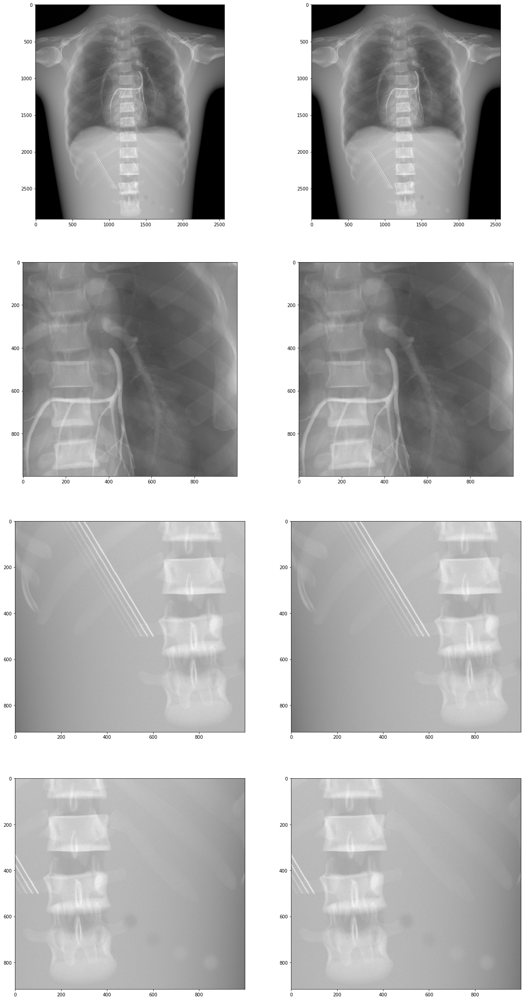

In [10]:
# Reconstruction
out = msp.im_out
f,ax = plt.subplots(4,2,figsize=(20,40))
ax[0,0].imshow(p)
ax[0,1].imshow(out)
ax[1,0].imshow(p[500:1500,1000:2000],vmin=p.min(),vmax=p.max())
ax[1,1].imshow(out[500:1500,1000:2000],vmin=out.min(),vmax=out.max())
ax[2,0].imshow(p[2000:,500:1500],vmin=p.min(),vmax=p.max())
ax[2,1].imshow(out[2000:,500:1500],vmin=out.min(),vmax=out.max())
ax[3,0].imshow(p[2000:,1000:2000],vmin=p.min(),vmax=p.max())
ax[3,1].imshow(out[2000:,1000:2000],vmin=out.min(),vmax=out.max())

### Conclusions

1. Il est plus facile d'identifier un contraste dans une image que dans une intégrale
2. L'identification du contraste dans l'image ne dépend pas de l'étendue de l'image (information locale)
3. L'identification du contraste dans l'intégrale dépend de l'étudentue du profil (information globale)
4. Le bruit de Poisson augmente avec $I_0$ mais le rapport signal à bruit (SNR) augmente également
5. Plus le bruit de Poisson augmente, plus il est difficile d'identifier la présence d'un saut de contraste dans l'intégrale
6. Une image en intensité est difficile à lire : on préfère repasser en dynamique linéaire par passage au log
7. Le rehaussement est une étape essentielle avant présentation de l'image au radiologue ; son réglage dépend de la tâche clinique et du "look-and-feel"
8. Dans une courbe de gain, le contraste est réglé par la pente (la dérivée) de la courbe

### Ouverture : les systèmes EOS/EOSedge et les limites de la radiographie numérique

Présentation en cours (diapositives disponibles après le cours).

Text(0.5, 1.0, 'Histogram of equalized image')

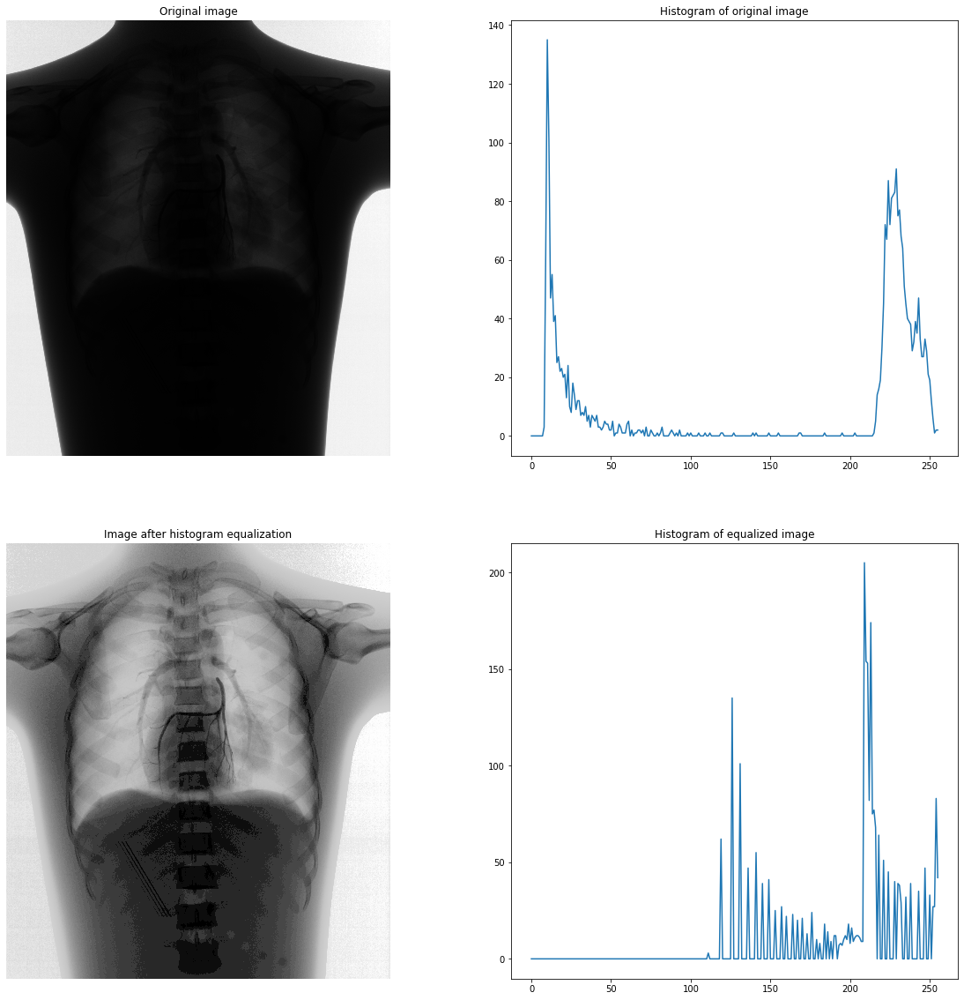

In [114]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
convert = rescale_intensity(I, in_range=(0, 2**14-1), out_range=np.uint8).astype(np.uint8)
hist = cv.calcHist(convert, [0], None, [256], (0, 256))

equalized = cv.equalizeHist(convert)
hist_equalized = cv.calcHist(equalized, [0], None, [256], (0, 256))

fig, ax = plt.subplots(2, 2, figsize=(20, 20))
ax[0, 0].imshow(convert, cmap='gray')
ax[0, 0].axis('off')
ax[0, 0].set_title('Original image')
ax[0, 1].plot(hist)
ax[0, 1].set_title('Histogram of original image')
ax[1, 0].imshow(equalized, cmap='gray')
ax[1, 0].axis('off')
ax[1, 0].set_title('Image after histogram equalization')
ax[1, 1].plot(hist_equalized)
ax[1, 1].set_title('Histogram of equalized image')

[   24.573107    90.6289     156.6847     222.7405     288.7963
   354.85208    420.90787    486.96365    553.0195     619.07526
   685.13104    751.1868     817.2426     883.2984     949.35425
  1015.41003   1081.4658    1147.5216    1213.5774    1279.6332
  1345.689     1411.7448    1477.8005    1543.8563    1609.9121
  1675.9679    1742.0238    1808.0796    1874.1354    1940.1912
  2006.247     2072.3027    2138.3584    2204.4143    2270.4702
  2336.526     2402.5818    2468.6375    2534.6934    2600.749
  2666.805     2732.8606    2798.9165    2864.9722    2931.028
  2997.0837    3063.1396    3129.1953    3195.2512    3261.307
  3327.3628    3393.4187    3459.4744    3525.5303    3591.586
  3657.6418    3723.6975    3789.7534    3855.809     3921.865
  3987.9207    4053.9766    4120.032     4186.088     4252.144
  4318.1997    4384.2554    4450.3115    4516.367     4582.423
  4648.4785    4714.5347    4780.5903    4846.646     4912.7017
  4978.758     5044.8135    5110.869     5176

Text(0.5, 1.0, 'Image histogram after CLAHE')

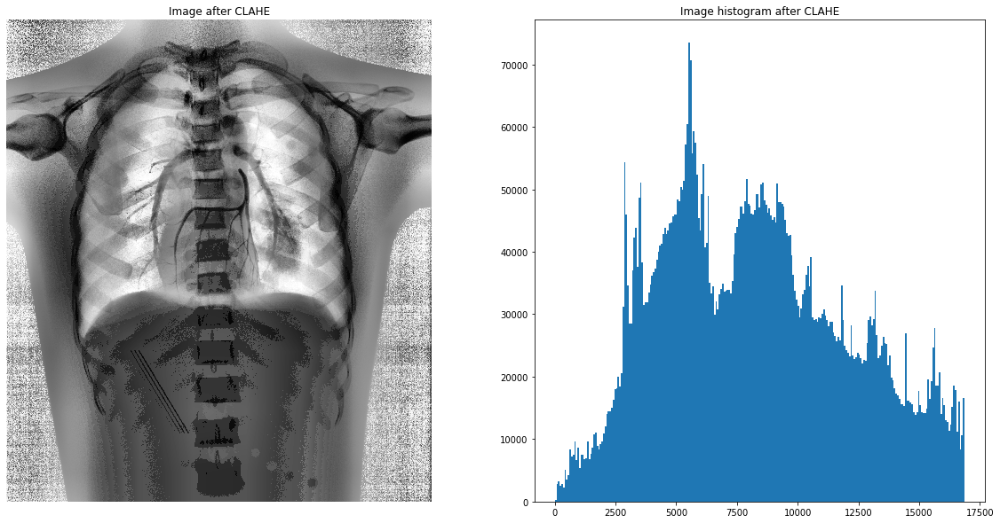

In [77]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
from skimage.exposure import equalize_adapthist, rescale_intensity

clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))
I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
I_min = I.min()
I_max = I.max()
convert = cv.normalize(I, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)

out = clahe.apply(convert)
out = cv.normalize(out, None, alpha=I_min, beta=I_max, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
#hist_equalized = cv.calcHist(equalized, [0], None, [256], (0, 256))

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(out, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Image after CLAHE')
ax[1].hist(out.flat, bins=255, range=(0, I_max))
ax[1].set_title('Image histogram after CLAHE')

In [84]:
# Courbe de gain
def improve_contrast(x,gamma=1,alpha=1,beta=0):
    #### Votre code ici
    return np.clip(alpha * (((x / 255) ** gamma) * 255) + beta, 0, 255)

In [87]:
def adjust_gamma(image, gamma=1.0):
	# build a lookup table mapping the pixel values [0, 255] to
	# their adjusted gamma values
	table = np.array([((i / 255.0) ** gamma) * 255
		for i in np.arange(0, 256)]).astype("uint8")
    
    # apply gamma correction using the lookup table
	return cv.LUT(image, table)

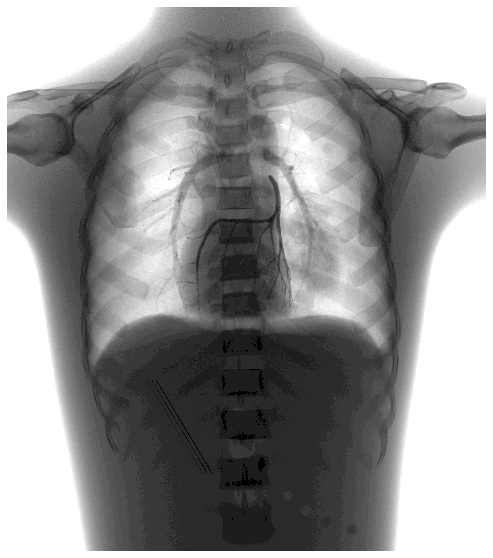

In [104]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
convert = cv.normalize(I, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)

convert = adjust_gamma(convert, 0.6)
test = cv.convertScaleAbs(convert, None, 2, 100)

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.axis('off')
ax.imshow(test, cmap='gray')

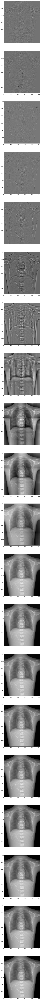

In [62]:
import numpy as np
import pywt
from matplotlib import pyplot as plt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
import cv2 as cv
from skimage.restoration import estimate_sigma

kernel = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
#I = cv.normalize(I, None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX, dtype=cv.CV_16U)
clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))
#I = clahe.apply(I)
    #draw_2d_wp_basis(I.shape, wavedec2_keys(i), ax=ax[0, i], label_levels=3)
    #ax[0, i].set_title('{} level\ndecomposition'.format(i), fontsize=10)

    #convert = cv.normalize(I, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
fig, ax = plt.subplots(20, 1, figsize=(10, 200))
for i in range(20):
    p_normalized = cv.normalize(p, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    c = pywt.wavedec2(p_normalized, 'db2', level=i+1)
    c[0] = np.zeros(c[0].shape)
    image = pywt.waverec2(c, 'db2')
    image = cv.normalize(image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    ax[i].imshow(image, cmap='gray')


    #min_value = c[0].min()
    #max_value = c[0].max()
    #c[0] = cv.normalize(c[0], None, alpha=0, beta=65535, norm_type=cv.NORM_MINMAX, dtype=cv.CV_16U)
    #c[0] = clahe.apply(c[0])
    #c[0] = cv.filter2D(c[0], -1, kernel)
    #c[0] = cv.normalize(c[0], None, alpha=min_value, beta=max_value, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)

    #for t in range(1, len(c)):
    #    detail_coeffs_list = []
    #    for k in range(2):
    #        min_value = c[t][k].min()
    #        max_value = c[t][k].max()
    #        temp = cv.normalize(c[t][k], None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    #        temp = cv.filter2D(temp, -1, kernel[k])
    #        temp = cv.normalize(temp, None, alpha=min_value, beta=max_value, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    #        detail_coeffs_list.append(temp)
    #    detail_coeffs_list.append(c[t][2])
    #    c[t] = detail_coeffs_list
    

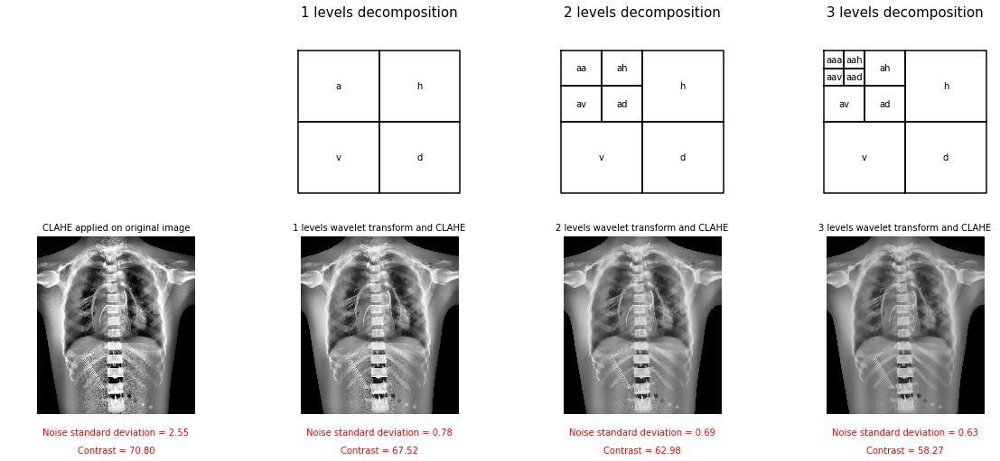

In [54]:
import numpy as np
import pywt
from matplotlib import pyplot as plt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
import cv2 as cv
from skimage.restoration import estimate_sigma
from skimage.metrics import peak_signal_noise_ratio

list_of_images = []
test = p.copy()
p_normalized = cv.normalize(p, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
test_normalized = cv.normalize(test, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
mask = np.array([test_normalized < 5]).reshape(test_normalized.shape)

clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))

fig, ax = plt.subplots(2, 4, figsize=(20, 8))

for i in range(4):
    if i == 0:
        cl1 = clahe.apply(test_normalized)
        cl1[mask] = p_normalized[mask]
        list_of_images.append(cl1)
        ax[0, i].axis('off')
        ax[1, i].set_title('CLAHE applied on original image', fontsize=10)
        ax[1, i].imshow(cl1, cmap=plt.cm.gray)
        ax[1, i].axis('off')
        ax[1, i].text(0.5, -0.1, 'Noise standard deviation = {:.2f}'.format(estimate_sigma(cl1)), horizontalalignment='center', verticalalignment='center', transform=ax[1, i].transAxes, fontsize=10, color='red')
        ax[1, i].text(0.5, -0.2, 'Contrast = {:.2f}'.format(cl1.std()), horizontalalignment='center', verticalalignment='center', transform=ax[1, i].transAxes, fontsize=10, color='red')
        mask = np.pad(mask, pad_width=[(0, 0), (0, 1)], mode='constant', constant_values=1)
        p_normalized = np.pad(p_normalized, pad_width=((0, 0), (0, 1)), mode='constant')
        continue

    draw_2d_wp_basis(p.shape, wavedec2_keys(i), ax=ax[0, i], label_levels=3)
    ax[0, i].set_title('{} levels decomposition'.format(i), fontsize=15)

    convert = cv.normalize(test_normalized, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    c = pywt.wavedec2(convert, 'db2', level=i)

    min_value = c[0].min()
    max_value = c[0].max()
    c[0] = cv.normalize(c[0], None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    c[0] = clahe.apply(c[0])
    c[0] = cv.normalize(c[0], None, alpha=min_value, beta=max_value, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    
    #for t in range(1, len(c)):
    #    detail_coeffs_list = []
    #    for k in range(2):
    #        min_value = c[t][k].min()
    #        max_value = c[t][k].max()
    #        temp = cv.normalize(c[t][k], None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    #        temp = cv.filter2D(temp, -1, kernel[k])
    #        temp = cv.normalize(temp, None, alpha=min_value, beta=max_value, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    #        detail_coeffs_list.append(temp)
    #    detail_coeffs_list.append(c[t][2])
    #    c[t] = detail_coeffs_list

    image = pywt.waverec2(c, 'db2')
    image = cv.normalize(image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    image[mask] = p_normalized[mask]
    list_of_images.append(image)

    ax[1, i].set_title('{} levels wavelet transform and CLAHE'.format(str(i)), fontsize=10)
    ax[1, i].imshow(image, cmap=plt.cm.gray)
    ax[1, i].axis('off')
    ax[1, i].text(0.5, -0.1, 'Noise standard deviation = {:.2f}'.format(estimate_sigma(image)), horizontalalignment='center', verticalalignment='center', transform=ax[1, i].transAxes, fontsize=10, color='red')
    ax[1, i].text(0.5, -0.2, 'Contrast = {:.2f}'.format(image.std()), horizontalalignment='center', verticalalignment='center', transform=ax[1, i].transAxes, fontsize=10, color='red')

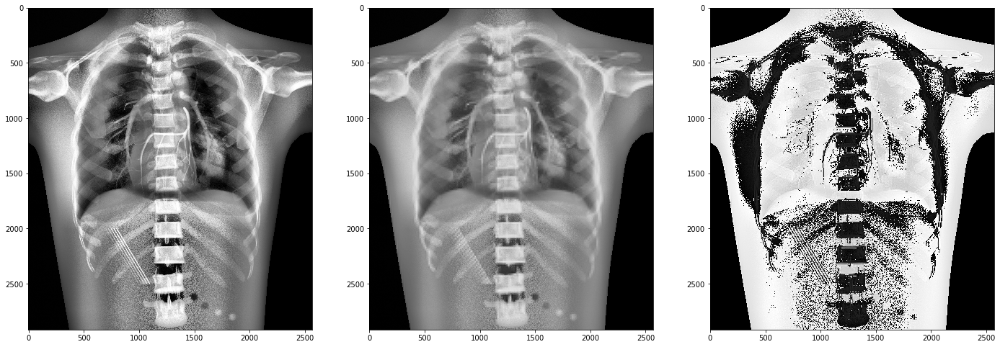

In [17]:
import numpy as np
import pywt
from matplotlib import pyplot as plt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
import cv2 as cv
from skimage.restoration import estimate_sigma
from skimage.metrics import peak_signal_noise_ratio

p_normalized = cv.normalize(p, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
test_normalized = cv.normalize(p, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
mask = np.array([test_normalized < 5]).reshape(test_normalized.shape)
clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))
cl1 = clahe.apply(test_normalized)
cl1[mask] = p_normalized[mask]

#mask = np.pad(mask, pad_width=[(0, 0), (0, 1)], mode='constant', constant_values=1)
#p_normalized = np.pad(p_normalized, pad_width=((0, 0), (0, 1)), mode='constant')

convert = cv.normalize(cl1, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
c = pywt.wavedec2(convert, 'db2', level=4)
for i in range(1, 4):
    c[i] = np.zeros(c[i][0].shape), np.zeros(c[i][1].shape), np.zeros(c[i][2].shape)

image = pywt.waverec2(c, 'db2')
image = cv.normalize(image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
image[:, :-1][mask] = p_normalized[mask]

fig, ax = plt.subplots(1, 3, figsize=(24, 10))
ax[0].imshow(cl1, cmap='gray')
ax[1].imshow(image[:, :-1], cmap='gray')
ax[2].imshow(cl1 - image[:, :-1], cmap='gray')

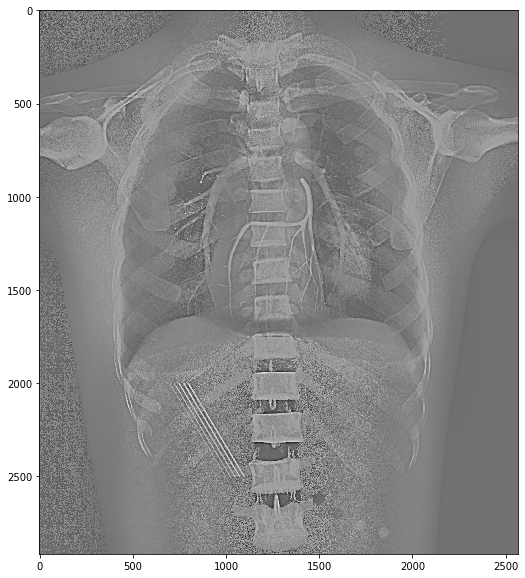

In [32]:
test_normalized = cv.normalize(p, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))
cl1 = clahe.apply(test_normalized)
low_pass = cv.GaussianBlur(cl1,(47,47),0)
out = cv.addWeighted(cl1, 1, low_pass, -0.4, 0)
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.imshow(out, cmap='gray')

(array([9.59129e+05, 2.65105e+05, 1.02209e+05, 2.55600e+04, 2.28700e+03,
        7.00000e+00, 1.10000e+01, 5.00000e+00, 1.00000e+01, 1.20000e+01,
        9.00000e+00, 1.40000e+01, 8.00000e+00, 9.00000e+00, 9.00000e+00,
        1.10000e+01, 1.20000e+01, 2.10000e+01, 1.20000e+01, 3.10000e+01,
        1.09000e+02, 4.66000e+02, 1.50200e+03, 2.76600e+03, 3.89300e+03,
        4.24500e+03, 4.78100e+03, 5.09600e+03, 5.67600e+03, 5.90000e+03,
        6.17000e+03, 5.82800e+03, 5.90800e+03, 6.06900e+03, 6.07900e+03,
        6.27400e+03, 6.22700e+03, 6.38700e+03, 6.67800e+03, 6.73600e+03,
        7.11300e+03, 7.41500e+03, 7.80600e+03, 7.93200e+03, 8.20700e+03,
        8.42000e+03, 9.01900e+03, 9.12700e+03, 9.55600e+03, 9.62600e+03,
        9.75700e+03, 1.00590e+04, 1.02020e+04, 1.04800e+04, 1.08050e+04,
        1.09950e+04, 1.11030e+04, 1.16530e+04, 1.17070e+04, 1.23490e+04,
        1.31760e+04, 1.37640e+04, 1.48870e+04, 1.58360e+04, 1.67590e+04,
        1.74350e+04, 1.84100e+04, 1.88160e+04, 1.95

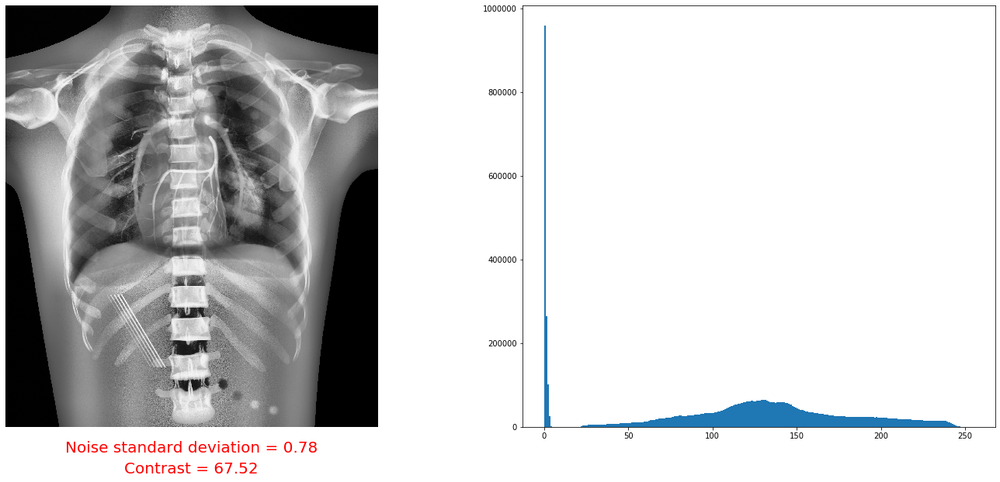

In [58]:
fig, ax = plt.subplots(1, 2, figsize=(24, 10))
image = list_of_images[1].copy()
ax[0].imshow(image, cmap='gray')
ax[0].axis('off')
ax[0].text(0.5, -0.05, 'Noise standard deviation = {:.2f}'.format(estimate_sigma(image)), horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes, fontsize=20, color='red')
ax[0].text(0.5, -0.1, 'Contrast = {:.2f}'.format(image.std()), horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes, fontsize=20, color='red')
ax[1].hist(image.flat, bins=255, range=(0, 255))

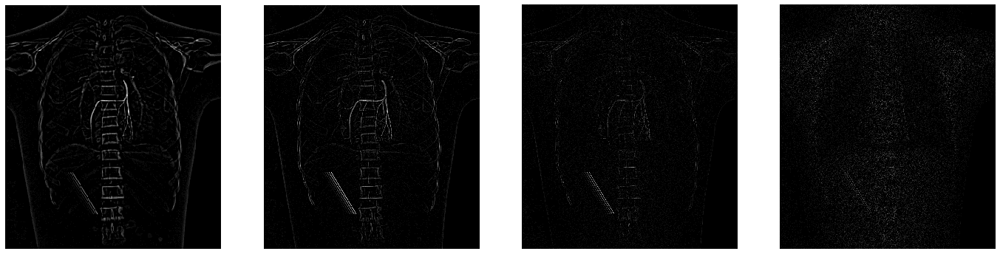

In [116]:
def laplacian_pyramid(list_of_images):
    list_of_laplacian_images = []
    for i in range(1, len(list_of_images)):
        size = (list_of_images[-(i + 1)].shape[1], list_of_images[-(i + 1)].shape[0])
        gaussian_expanded = cv.pyrUp(list_of_images[-i], dstsize=size)
        laplacian = cv.subtract(list_of_images[-(i + 1)], gaussian_expanded)
        list_of_laplacian_images.append(laplacian)
    return list_of_laplacian_images

clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))

p_normalized = cv.normalize(p, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
# Create a Gaussian Pyramid
gaussian_pyr = [p_normalized]
p_lower = p_normalized.copy()
for i in range(4):
    p_lower = cv.pyrDown(p_lower)
    gaussian_pyr.append(p_lower)
 
# Create a Laplacian Pyramid
laplacian_pyr = []
for i in range(1, 5):
    size = (gaussian_pyr[-(i + 1)].shape[1], gaussian_pyr[-(i + 1)].shape[0])
    gaussian_expanded = cv.pyrUp(gaussian_pyr[-i], dstsize=size)
    laplacian = cv.subtract(gaussian_pyr[-(i + 1)], gaussian_expanded)
    laplacian = cv.normalize(laplacian, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    laplacian_pyr.append(laplacian)

fig, ax = plt.subplots(1, 4, figsize=(24, 10))
for i in range(4):
    ax[i].imshow(laplacian_pyr[i], cmap='gray')
    ax[i].axis('off')

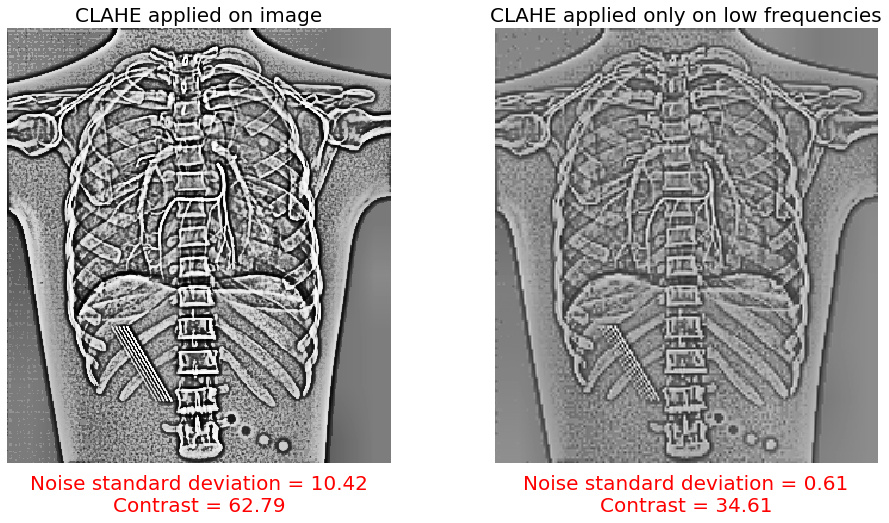

In [105]:
import numpy as np
import pywt
from matplotlib import pyplot as plt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
import cv2 as cv
from skimage.restoration import estimate_sigma
from skimage.metrics import peak_signal_noise_ratio

image = laplacian_pyr[0].copy()
clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))

fig, ax = plt.subplots(1, 2, figsize=(16, 8))

first_image = clahe.apply(image)

convert = cv.normalize(image, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
c = pywt.wavedec2(convert, 'db2', level=1)

min_value = c[0].min()
max_value = c[0].max()
c[0] = cv.normalize(c[0], None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
c[0] = clahe.apply(c[0])
c[0] = cv.normalize(c[0], None, alpha=min_value, beta=max_value, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)

second_image = pywt.waverec2(c, 'db2')
second_image = cv.normalize(second_image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)

two_image = [first_image, second_image]

for i in range(2):
    if i == 0:
        ax[i].set_title('CLAHE applied on image', fontsize=20)
    else:
        ax[i].set_title('CLAHE applied only on low frequencies', fontsize=20)
    ax[i].imshow(two_image[i], cmap=plt.cm.gray)
    ax[i].axis('off')
    ax[i].text(0.5, -0.05, 'Noise standard deviation = {:.2f}'.format(estimate_sigma(two_image[i])), horizontalalignment='center', verticalalignment='center', transform=ax[i].transAxes, fontsize=20, color='red')
    ax[i].text(0.5, -0.1, 'Contrast = {:.2f}'.format(two_image[i].std()), horizontalalignment='center', verticalalignment='center', transform=ax[i].transAxes, fontsize=20, color='red')

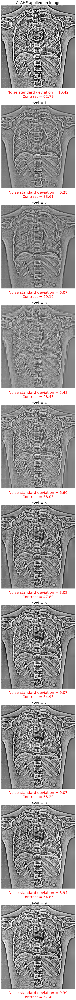

In [114]:
import numpy as np
import pywt
from matplotlib import pyplot as plt
from pywt._doc_utils import wavedec2_keys, draw_2d_wp_basis
import cv2 as cv
from skimage.restoration import estimate_sigma
from skimage.metrics import peak_signal_noise_ratio

list_of_images = []
image = laplacian_pyr[0].copy()
clahe = cv.createCLAHE(clipLimit=40.0, tileGridSize=(8,8))

fig, ax = plt.subplots(10, 1, figsize=(10, 100))

first_image = clahe.apply(image)
list_of_images.append(first_image)
convert = cv.normalize(first_image, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
for j in range(1, 10):
    c = pywt.wavedec2(convert, 'db2', level=j)
    c[1] = (np.zeros(c[1][0].shape), np.zeros(c[1][1].shape), np.zeros(c[1][2].shape))

    new_image = pywt.waverec2(c, 'db2')
    new_image = cv.normalize(new_image, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8U)
    list_of_images.append(new_image)

for i in range(10):
    if i == 0:
        ax[i].set_title('CLAHE applied on image', fontsize=20)
    else:
        ax[i].set_title('Level = {}'.format(i), fontsize=20)
    ax[i].imshow(list_of_images[i], cmap=plt.cm.gray)
    ax[i].axis('off')
    ax[i].text(0.5, -0.05, 'Noise standard deviation = {:.2f}'.format(estimate_sigma(list_of_images[i])), horizontalalignment='center', verticalalignment='center', transform=ax[i].transAxes, fontsize=20, color='red')
    ax[i].text(0.5, -0.1, 'Contrast = {:.2f}'.format(list_of_images[i].std()), horizontalalignment='center', verticalalignment='center', transform=ax[i].transAxes, fontsize=20, color='red')


[  0 248 249 250 251 252 253 254 255]
16383
16868.8
0
0


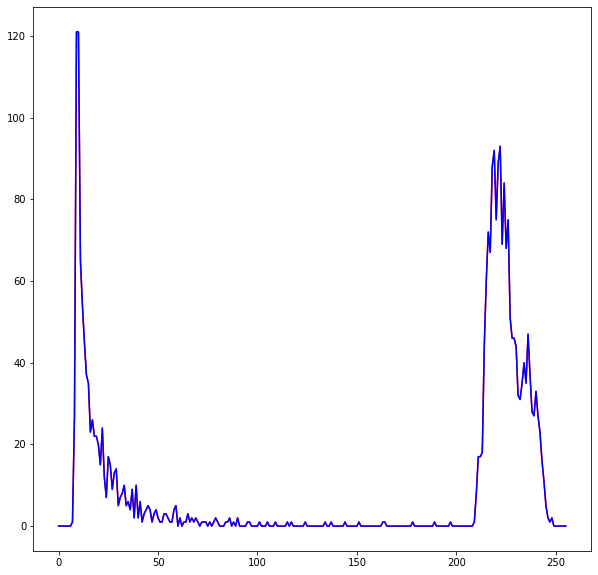

In [112]:
from skimage.exposure import rescale_intensity

I = np.fromfile('data/I.2569.2916.raw',dtype='float32').reshape((2916,2569))
convert = rescale_intensity(I, in_range=(0, 2**14-1), out_range=np.uint8).astype(np.uint8)

convert_hist = cv.calcHist(convert, [0], None, [256], (0, 256))

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.plot(convert_hist, color='red')